# Reinforcement Learning: DQN

- As before, please keep the names of the layer consistent with what is requested in model.py. Otherwise the test functions will not work

- You will need to fill in the model.py, DQN.py, replay_buffer.py, and env_wrapper.py.

To avoid pain with installation and model training, please use Colab for this project. DO NOT use Windows for this project. If you use Mac, there might be some potential test case failures you need to address with extra effort.

## Set up

In [1]:
# mount it if you use Colab
# from google.colab import drive
# drive.mount('/content/drive')

In [2]:
# TODO: change the dir to your folder
# %cd /content/drive/MyDrive/YOUR_FOLDER_NAME

In [3]:
%load_ext autoreload
%autoreload 2

In [ ]:
!pip install numpy torch wandb swig matplotlib termcolor 

!pip install gymnasium
!pip install gymnasium[box2d]

In [4]:
import rl_test
from utils import *

## Introduction to the Enviroment (5 points)
We will be training a DQN agent to play the game of CarRacing. The agent will be trained to play the game using the pixels of the game as an input. The reward structure is as follows for each frame:
- -0.1 for each frame
- +1000/N where N is the number of tiles visited by the car in the episode

The overall goal of this game is to design a agent that is able to play the game with a average test score of above 600. In discrete mode the actions can take 5 actions,
- 0: Do Nothing
- 1: Turn Left
- 2: Turn Right
- 3: Accelerate
- 4: Brake

First let us visualize the game and understand the environment.

In [5]:
import gymnasium as gym
import numpy as np
env = gym.make('CarRacing-v3', continuous=False, render_mode='rgb_array')
env.np_random = np.random.RandomState(42)

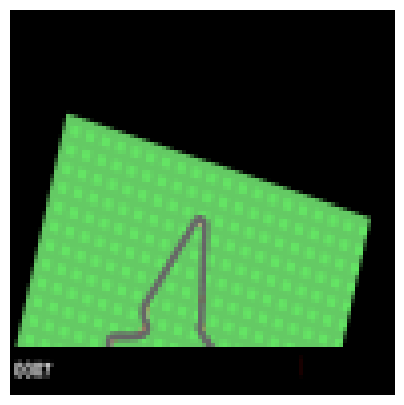

In [6]:
from IPython.display import HTML

frames = []
s, _ = env.reset()

while True:
    a = env.action_space.sample()
    s, r, terminated, truncated, _ = env.step(a)
    frames.append(s)
    if terminated or truncated:
        break

anim = animate(frames)
HTML(anim.to_jshtml())

So a couple things we can note:
- at the beginning of the game, we have 50 frames of the game slowly zooming into the car, we should ignore this period, ie no-op during this period.
- there is a black bar at the bottom of the screen, we should crop this out of the observation.

In addition, another thing to note is that the current frame doesn't give much information about the velocity and acceleration of the car, and that the car does not move much for each frame.

### Environment Wrapper (5 points)
As a result, you will need to complete `EnvWrapper` in `env_wrapper.py`. You can find more information in the docstring for the wrapper, however the main idea is that it is a wrapper to the environment that does the following:
- skips the first 50 frames of the game
- crops out the black bar and reshapes the observation to a 84x84 image, as well as turning the resulting image to grayscale
- performs the actions for `skip_frames` frames
- stacks the last `num_frames` frames together to give the agent some information about the velocity and acceleration of the car.


In [7]:
from env_wrapper import EnvWrapper

rl_test.test_wrapper(EnvWrapper)

Passed reset
Passed step


## DQN (25 points)

### CNN Model (5 points)
Now we are ready to build the model. Our architecture of the CNN model is the one proposed by Mnih et al in "Human-level control through deep reinforcement learning". Specifically this consists of the following layers:
- A convolutional layer with 32 filters of size 8x8 with stride 4 and relu activation
- A convolutional layer with 64 filters of size 4x4 with stride 2 and relu activation
- A convolutional layer with 64 filters of size 3x3 with stride 1 and relu activation
- A fully connected layer with 512 units and relu activation
- A fully connected layer with the number of outputs of the environment

Please implement this model `Nature_Paper_Conv` in `model.py` as well as the helper
`MLP` class.

In [34]:
import model
rl_test.test_model_DQN(model.Nature_Paper_Conv)

Passed


Now we are ready to implement the DQN algorithm.

![title](DQN.png)

### Replay Buffer (5 points)
First start by implementing the DQN replay buffer `ReplayBufferDQN` in `replay_buffer.py`. This buffer will store the transitions of the agent and sample them for training.

In [12]:
from replay_buffer import ReplayBufferDQN

rl_test.test_DQN_replay_buffer(ReplayBufferDQN)

Passed



### DQN (15 points)
Now implement the `_optimize_model` and `_sample_action` functions in `DQN` in `DQN.py`. The `_optimize_model` function will sample a batch of transitions from the replay buffer and update the model. The `_sample_action` function will sample an action from the model given the current state. Train the model over 200 episdoes, validating every 50 episodes for 30 episodes, before testing the model for 50 episodes at the end.

In [41]:
import wandb

In [42]:
wandb.login()

wandb: WARNING Calling wandb.login() after wandb.init() has no effect.


True

In [43]:
wandb.init(project="racing-car-dqn")

loss,▁▁▁▄▄▄▄▅▅▅▆▆▇▆▆▇▆▇█▇█▇▇▇▇▇▆█▇▇▇▇▇▆▇▇▇█▇█
mean_reward,▁▇▇█
mean_test_reward,▁
std_reward,▁▄▇█
std_test_reward,▁
total_reward,▁▁▁▁▃▆▂▃▁▆▂▄▅▃▃▆▄▅▆▄▅▇▆▆▆▇▆▇█▆▇▆▇▆█▄▅▄▇▅
loss,7.2015
mean_reward,602.84853
mean_test_reward,612.64892
std_reward,245.65705
std_test_reward,226.5224


In [40]:
import DQN
import utils
import torch

# if running with Colab T4 with wandb, it takes 60-70 mins
# if running with Colab T4 w/o wandb, it takes ~30 mins
# your test mean reward idealy should be larger than 400
trainerDQN = DQN.DQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = True,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 700, 0.1),
                save_path = utils.get_save_path("DQN","./runs/"))

trainerDQN.train(200, 50, 30, 50, 50)



saving to ./runs/DQN\run7


Episode: 0: Time: 10.41840410232544 Total Reward: -39.26229508196796 Avg_Loss: 0.0
Episode: 1: Time: 11.983267068862915 Total Reward: -31.026936026936216 Avg_Loss: 0.7158113004770249
Episode: 2: Time: 12.824692726135254 Total Reward: -38.85964912280717 Avg_Loss: 0.766091323418527
Episode: 3: Time: 12.254519939422607 Total Reward: -66.51898734177271 Avg_Loss: 0.7612796291677641
Episode: 4: Time: 12.570411920547485 Total Reward: -61.10169491525477 Avg_Loss: 0.7737837037807253
Episode: 5: Time: 12.345689535140991 Total Reward: -41.20253164557051 Avg_Loss: 0.5726315365681628
Episode: 6: Time: 13.226217269897461 Total Reward: -59.48087431694043 Avg_Loss: 0.6466032837619301
Episode: 7: Time: 13.40157413482666 Total Reward: -58.963963963964474 Avg_Loss: 0.554449875267739
Episode: 8: Time: 12.373532772064209 Total Reward: -40.25547445255522 Avg_Loss: 0.5974845245261403
Episode: 9: Time: 12.652466058731079 Total Reward: -52.7922077922085 Avg_Loss: 0.5999336821347976
Episode: 10: Time: 11.971602

Please include a plot of the training and validation rewards over the episodes in the report. Answer the question in no more than 2 sentences: Does the loss matter in DQN? Why or why not?

![](./graphs/dqn_NEW.png)

Your answer: The actual value of the loss in DQN does not necessarily need to be minimized or converge to 0 like in other deep learning architectures. It provides a way to train the DQN model and behaves more like a training signal that we can see how the model is training. It is minimized with respect to the loss function to tell the model how to update its parameters. The reward rather than loss is the endgame matric that is more important in telling whether a model is performing well. 


#### Animation

We can also draw a animation of the car in one game, the code is provided below. The animation is just for your reference to get a feeling of how good your model is. No need to submit in your submission. We will grade based on your plots of training and validation above.

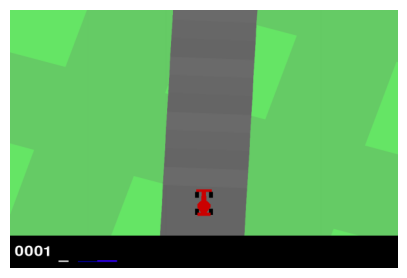

In [46]:
eval_env = gym.make('CarRacing-v3', continuous=True, render_mode='rgb_array')
eval_env = EnvWrapper(eval_env)

total_rewards, frames = trainerDQN.play_episode(0, True, 42)
anim = animate(frames)
HTML(anim.to_jshtml())

## Double DQN (10 points)
In the original paper, where the algorithim is shown above, the estimated target Q value was computed using the current Q network's weights. However, this can lead to overestimation of the Q values. To mitigate this, we can use the target network to compute the target Q value. This is known as Double DQN.

### Hard updating Target Network (5 points)
Original implementations for this involved hard updates, where the model weights were copied to the target network every C steps. This is known as hard updating. This was what was used in the Nature Paper by Mnih et al 2015 "Human-level control through deep reinforcement learning"

Please implement this by implementing the `_optimize_model` and `_update_model` classes in `HardUpdateDQN` in `DQN.py`.

In [47]:
import torch
import utils
import DQN
import model
from env_wrapper import EnvWrapper

trainerHardUpdateDQN = DQN.HardUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                update_freq = 100,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = True,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000, 0.1),
                save_path = utils.get_save_path("DoubleDQN_HardUpdates/","./runs/"))

trainerHardUpdateDQN.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_HardUpdates/run5


Episode: 0: Time: 9.030044794082642 Total Reward: -39.26229508196796 Avg_Loss: 0.0
Episode: 1: Time: 12.198569536209106 Total Reward: -31.026936026936216 Avg_Loss: 0.7154949867658934
Episode: 2: Time: 12.48585844039917 Total Reward: -45.87719298245635 Avg_Loss: 0.7540682105801436
Episode: 3: Time: 12.210618019104004 Total Reward: -72.84810126582299 Avg_Loss: 0.6899322261329458
Episode: 4: Time: 12.831844568252563 Total Reward: -30.59322033898307 Avg_Loss: 0.6975173255459977
Episode: 5: Time: 12.181439399719238 Total Reward: -53.86075949367158 Avg_Loss: 0.6173514747413016
Episode: 6: Time: 12.884264469146729 Total Reward: -21.22950819672124 Avg_Loss: 0.6031309375930735
Episode: 7: Time: 12.873837947845459 Total Reward: -70.97597597597624 Avg_Loss: 0.6004267126447013
Episode: 8: Time: 12.817373752593994 Total Reward: 61.93430656934382 Avg_Loss: 0.6688636523679274
Episode: 9: Time: 12.477854013442993 Total Reward: -20.32467532467539 Avg_Loss: 0.8492494189814359
Episode: 10: Time: 11.75644

![Project4_skeleton\dqn_1.png](./graphs/dqn_2.png)

#### Animation

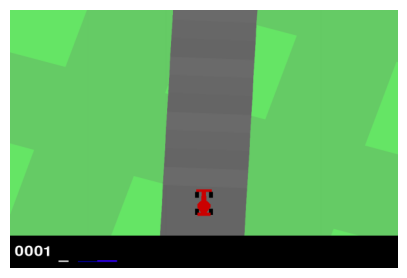

In [48]:
total_rewards, frames = trainerHardUpdateDQN.play_episode(0, True, 42)
anim = animate(frames)
HTML(anim.to_jshtml())

### Soft Updates (5 points)
A more recent improvement is to use soft updates, also known as Polyak averaging, where the target network is updated with a small fraction of the current model weights every step. In other words:
$$\theta_{target} = \tau \theta_{model} + (1-\tau) \theta_{target}$$
for some $\tau << 1$
Please implement this by implementing the `_update_model` class in `SoftUpdateDQN` in `DQN.py`.

In [49]:
import torch
import utils
import DQN
import model
from env_wrapper import EnvWrapper

traineSoftUpdateDQN = DQN.SoftUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                tau = 0.01,
                update_freq = 1,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,   # You can take smaller buffer size if you encounter RAM explosion
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = True,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000,0.1),
                save_path = utils.get_save_path("DoubleDQN_SoftUpdates","./runs/"))

traineSoftUpdateDQN.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_SoftUpdates\run4


loss,▁▂▂▂▂█▃▄▄▄▆▆▆▇▆▆▇▆▇▇▇▇▇▇▆▇▆▆▇▇█▇▇██▇███▇
mean_reward,▁███
mean_test_reward,▁
std_reward,▇█▅▁
std_test_reward,▁
total_reward,▁▁▁▁▁▂▃▄▅▅▁▃▅▄▄▅▅▄▄▇█▇▅▄▆▆▅▄▄▆▅▅▄▅▄▅▄▃▄▅
loss,7.22071
mean_reward,532.82163
mean_test_reward,530.32428
std_reward,141.52429
std_test_reward,182.73926


Episode: 0: Time: 10.467818260192871 Total Reward: -39.26229508196796 Avg_Loss: 0.0
Episode: 1: Time: 13.964409112930298 Total Reward: -31.026936026936216 Avg_Loss: 0.7164770367608708
Episode: 2: Time: 15.831659078598022 Total Reward: -45.87719298245635 Avg_Loss: 0.7514216403062103
Episode: 3: Time: 15.416771173477173 Total Reward: -72.84810126582299 Avg_Loss: 0.6825212255558547
Episode: 4: Time: 15.44814658164978 Total Reward: -54.32203389830555 Avg_Loss: 0.6645333523541188
Episode: 5: Time: 15.453431367874146 Total Reward: -60.18987341772248 Avg_Loss: 0.5597796598684137
Episode: 6: Time: 15.824395656585693 Total Reward: -64.94535519125766 Avg_Loss: 0.536133841940147
Episode: 7: Time: 15.497333765029907 Total Reward: -70.9759759759762 Avg_Loss: 0.4988086390027291
Episode: 8: Time: 14.911505222320557 Total Reward: -11.058394160584319 Avg_Loss: 0.5433199527759512
Episode: 9: Time: 2790.820252895355 Total Reward: -62.532467532468075 Avg_Loss: 0.6256114370776575
Episode: 10: Time: 14.4432

![Project4_skeleton\dqn_1.png](./graphs/dqn_3.png)

#### Animation

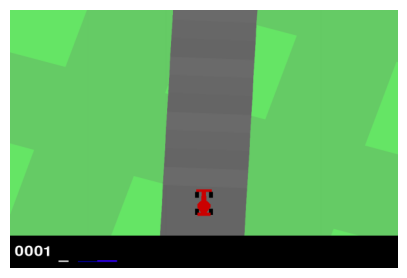

In [50]:
total_rewards, frames = traineSoftUpdateDQN.play_episode(0, True, 42)
anim = animate(frames)
HTML(anim.to_jshtml())

## Questions (10 points)
- Which method performed better? (5 points)

Your answer: Qualitatively, soft update DQN performed the best compared to normal DQN and hard update DQN. It performs with more stabilty and stays on the track more robustly. 

- If we modify the $\tau$ for soft updates **or** the $C$ for the hard updates, how does this affect the performance of the model, come up with a intuition for this, then experimentally verify this.
 (5 points)

Your answer: Intuitively for C, if we have a lower C, the model will update more frequently which could speed training but could be less stable  and if we have a larger C, the model will update less frequently and have more stability but could have outdated targets for longer. For tau, having a lower tau means smaller updates with fewer updates which could make the model learn very slowly. A higher tau means the model would learn much faster but risk being unstable. Below shows our intuition verified experimentally by increasing our tau and C values and showing both the graphs and animation. 

In [51]:
import torch
import utils
import DQN
import model
from env_wrapper import EnvWrapper

trainerHardUpdateDQN = DQN.HardUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                update_freq = 250,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = True,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000, 0.1),
                save_path = utils.get_save_path("DoubleDQN_HardUpdates/","./runs/"))

trainerHardUpdateDQN.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_HardUpdates/run6


i_update,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇████
loss,▁▁▁▁▁▂▃▃▄▅▆▅▆▆▆▇▇▇▇▆█▇▇▇▇▇▇▇▇▆▇▇▇▇▇█▇███
mean_reward,▁██▄
mean_test_reward,▁
std_reward,█▅▃▁
std_test_reward,▁
tau,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
total_reward,▁▁▁▁▃▆▁▂▆▆▄▇▆▃▅▄▅▆▃▄▆▆▆▇▇▇▆▅█▅▅▆▅▇▅▆▅▇▇▇
i_update,47232
loss,7.49898
mean_reward,546.77902


Episode: 0: Time: 10.498817443847656 Total Reward: -39.26229508196796 Avg_Loss: 0.0
Episode: 1: Time: 14.715672016143799 Total Reward: -31.026936026936216 Avg_Loss: 0.7151820488796112
Episode: 2: Time: 16.22801947593689 Total Reward: -45.87719298245635 Avg_Loss: 0.7502202069809457
Episode: 3: Time: 16.540249347686768 Total Reward: -76.01265822784814 Avg_Loss: 0.6751248361464558
Episode: 4: Time: 16.439415454864502 Total Reward: -44.152542372881925 Avg_Loss: 0.6281502617585684
Episode: 5: Time: 16.397594690322876 Total Reward: -41.20253164557059 Avg_Loss: 0.5875176617938305
Episode: 6: Time: 16.40333867073059 Total Reward: -21.229508196721397 Avg_Loss: 0.5872596201306882
Episode: 7: Time: 16.48035216331482 Total Reward: -70.97597597597621 Avg_Loss: 0.59563328187224
Episode: 8: Time: 14.595988035202026 Total Reward: -22.00729927007295 Avg_Loss: 0.6222489769687923
Episode: 9: Time: 15.629883050918579 Total Reward: -59.28571428571504 Avg_Loss: 0.618134694987861
Episode: 10: Time: 15.557435

![asdadasd](./graphs/dqn_4.png)

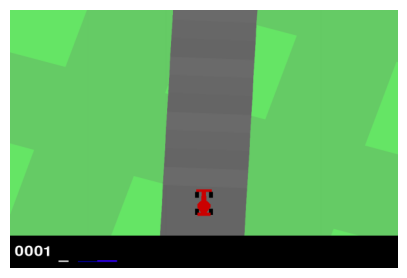

In [52]:
total_rewards, frames = trainerHardUpdateDQN.play_episode(0, True, 42)
anim = animate(frames)
HTML(anim.to_jshtml())

In [53]:
import torch
import utils
import DQN
import model
from env_wrapper import EnvWrapper

traineSoftUpdateDQN = DQN.SoftUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                tau = 0.2,
                update_freq = 1,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size = 100000,   # You can take smaller buffer size if you encounter RAM explosion
                batch_size = 32,
                loss_fn = "mse_loss",
                use_wandb = True,
                device = 'cuda',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000,0.1),
                save_path = utils.get_save_path("DoubleDQN_SoftUpdates","./runs/"))

traineSoftUpdateDQN.train(200, 50, 30, 50, 50)

saving to ./runs/DoubleDQN_SoftUpdates\run5


loss,▁▁▁▁▃▃▃▃▃▃▃▄▅▅▅▅▆▅▆▆█▆▇▇▇▇▆▆▆▇▆▆▆▆▆▆▆▆▆▆
mean_reward,▁▆█▇
mean_test_reward,▁
std_reward,▁█▅▆
std_test_reward,▁
total_reward,▁▁▂▅▄▄▄▄▄▁▅▄▄▃▄▅▇▆▆▆▄▆█▆▇▅█▆▃▆▇▄▇▃▄▆▅▇▅▇
loss,5.96865
mean_reward,546.10572
mean_test_reward,593.00382
std_reward,132.65452
std_test_reward,110.9085


Episode: 0: Time: 10.552185773849487 Total Reward: -39.26229508196796 Avg_Loss: 0.0
Episode: 1: Time: 14.906909704208374 Total Reward: -31.026936026936216 Avg_Loss: 0.7159428701136902
Episode: 2: Time: 16.07846212387085 Total Reward: -45.87719298245635 Avg_Loss: 0.7500556560405413
Episode: 3: Time: 15.864782810211182 Total Reward: -76.01265822784814 Avg_Loss: 0.6850227668505757
Episode: 4: Time: 16.54073214530945 Total Reward: -23.813559322034138 Avg_Loss: 0.7293838868308969
Episode: 5: Time: 16.358059644699097 Total Reward: -47.53164556962122 Avg_Loss: 0.7028194178803628
Episode: 6: Time: 16.693506956100464 Total Reward: -67.67759562841594 Avg_Loss: 0.6352234978009673
Episode: 7: Time: 15.616825103759766 Total Reward: -79.98498498498473 Avg_Loss: 0.6240107029864267
Episode: 8: Time: 15.436137914657593 Total Reward: -76.7518248175184 Avg_Loss: 0.5754938406102797
Episode: 9: Time: 15.80555272102356 Total Reward: -0.8441558441565431 Avg_Loss: 0.7340230937233242
Episode: 10: Time: 15.1929

![pro](./graphs/dqn_5.png)

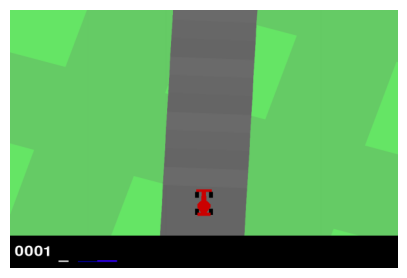

In [54]:
total_rewards, frames = traineSoftUpdateDQN.play_episode(0, True, 42)
anim = animate(frames)
HTML(anim.to_jshtml())